# Project NLP Part 2

Members:
- Ahmed MAALOUL
- Martin PUJOL

## 0. Importing Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip "/content/drive/MyDrive/ESILV/NLP/Project/part2/Traduction avis clients.zip" -d "/content/drive/MyDrive/ESILV/NLP/Project/part2/Traduction avis client"

Archive:  /content/drive/MyDrive/ESILV/NLP/Project/part2/Traduction avis clients.zip
replace /content/drive/MyDrive/ESILV/NLP/Project/part2/Traduction avis client/Traduction avis clients/avis_25_traduit.xlsx? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
cd = "/content/drive/MyDrive/ESILV/NLP/Project/part2/Traduction avis client/Traduction avis clients/"

In [ ]:
import pandas as pd

data = pd.read_excel(cd + "avis_1_traduit.xlsx")
for i in range(2,35):
  data = pd.concat((data,(pd.read_excel(cd + "avis_" + str(i) + "_traduit.xlsx"))))


In [ ]:
data.head()

,note,auteur,avis,assureur,produit,type,date_publication,date_exp,avis_en,avis_cor,avis_cor_en
0,5.0,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute,...",Direct Assurance,auto,train,06/09/2021,01/09/2021,"Best insurance, price, solutions, listening, s...",NaN,NaN
1,4.0,bernard-g-112497,"je suis globalement satisfait , sauf que vous ...",Direct Assurance,auto,train,03/05/2021,01/05/2021,"I am generally satisfied, except that you have...",NaN,NaN
2,5.0,virginie-t-107352,Prix tres abordable plusieurs options s'offren...,Direct Assurance,auto,train,21/03/2021,01/03/2021,Very affordable price Several options are avai...,NaN,NaN
3,4.0,boulain-f-116580,"je satisfait du service, une réponse très rapi...",L'olivier Assurance,auto,train,10/06/2021,01/06/2021,"I satisfy the service, a very fast response fr...",NaN,NaN
4,1.0,ouaille31-51798,"Client depuis plus de 25 ans, très déçu de cet...",Matmut,auto,train,29/01/2017,01/01/2017,"Customer for more than 25 years, very disappoi...",NaN,NaN


## I. Data Cleaning and Preprocessing (2/19)

1. **Clean the Dataset:**
    - Remove unnecessary or irrelevant entries.


In [ ]:
print(data.columns.values)

['note' 'auteur' 'avis' 'assureur' 'produit' 'type' 'date_publication'
 'date_exp' 'avis_en' 'avis_cor' 'avis_cor_en']


In [ ]:
print(data.shape)

(34000, 11)


We have 34000 datas with 11 features but we are just interest in the text feature and to make classification / rating / sentiment analysis from it.iter
We might consider only keep 'note' and 'avis' but it could be interesting to see the bias on the note from feature such as 'date', 'assureur' ...
We could also interest in how the corpus evole in time.

🟥

In [ ]:
data.isna().sum()

,0
note,9896
auteur,1
avis,0
assureur,0
produit,0
type,0
date_publication,0
date_exp,0
avis_en,2
avis_cor,34000


Looking at null values, we can see there is 2 unavailable translated reviews.

We also see that there is a lot of missing values for 'note', looking further we remark that test data are unlabbeled

In [ ]:
data.drop(["avis_cor", "avis_cor_en"], axis = 1, inplace = True)

In [ ]:
data_test = data[data["type"] == "test"].copy()
data_train= data[data["type"] == "train"].copy()


In [ ]:
data_test.isna().sum()

,0
note,9896
auteur,0
avis,0
assureur,0
produit,0
type,0
date_publication,0
date_exp,0
avis_en,1


In [ ]:
data_train.isna().sum()

,0
note,0
auteur,1
avis,0
assureur,0
produit,0
type,0
date_publication,0
date_exp,0
avis_en,1


So finally we drop the only uncomplete data of the training dataset and initially assign 0 note to testing data.

In [ ]:
data_train.drop(["type"], axis = 1, inplace = True)
data_test.drop(["type"], axis = 1, inplace = True)

data_train.dropna(inplace = True)
data_test['note'] = 0
data_test.dropna(inplace = True)

In [ ]:
data_train.head(3)

,note,auteur,avis,assureur,produit,date_publication,date_exp,avis_en
0,5.0,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute,...",Direct Assurance,auto,06/09/2021,01/09/2021,"Best insurance, price, solutions, listening, s..."
1,4.0,bernard-g-112497,"je suis globalement satisfait , sauf que vous ...",Direct Assurance,auto,03/05/2021,01/05/2021,"I am generally satisfied, except that you have..."
2,5.0,virginie-t-107352,Prix tres abordable plusieurs options s'offren...,Direct Assurance,auto,21/03/2021,01/03/2021,Very affordable price Several options are avai...


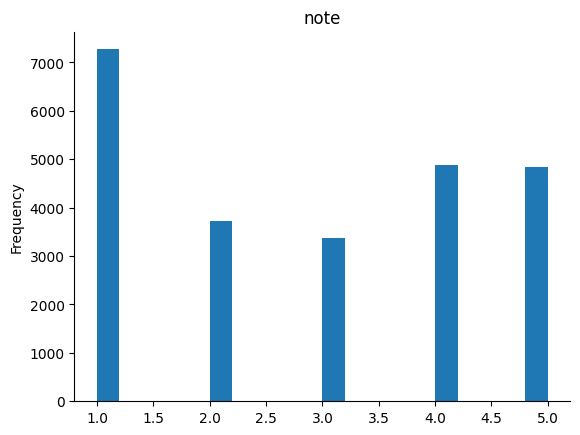

In [ ]:
from matplotlib import pyplot as plt
data_train['note'].plot(kind='hist', bins=20, title='note')
plt.gca().spines[['top', 'right',]].set_visible(False)

2. **Inspect and Adjust Spelling:**
    - Tokenize
    - Perform spelling correction on the dataset to standardize word usage.


Then we can split and tokanized our text features

In [ ]:
pip install nltk gensim pyspellchecker tqdm

In [ ]:
import pandas as pd
import numpy as np
import re
import nltk
from gensim.models import Word2Vec
from nltk.tokenize import TreebankWordTokenizer
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from spellchecker import SpellChecker
from tqdm import tqdm
from nltk.tokenize import word_tokenize, PunktSentenceTokenizer
from sklearn.feature_extraction.text import TfidfVectorizer


# Download necessary NLTK data
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download("punkt")
nltk.download("punkt_tab")
nltk.download("averaged_perceptron_tagger_eng")

from nltk.corpus import stopwords
stop_words = set(stopwords.words("english"))
punkt_tokenizer = PunktSentenceTokenizer()

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!


- Advanced Cleaning:
  - Remove Numbers: Depending on your use case, numbers
  might be irrelevant.
  - Handle Contractions: Expand contractions for consistency.
  - Remove URLs and HTML Tags: Clean web-sourced text.
  - Remove Emojis and Special Characters: Simplify the text.
- Spell Correction:
  - Correct Misspelled Words: Improve text quality.
  - Lemmatization/Stemming:
  - Normalize Words: Reduce words to their base forms.
- Remove Irrelevant Words:
  - Remove Stop Words
  - Frequency-Based Filtering: Remove extremely rare or overly common words.
- Tokenization Enhancements:
  - Handle Negations: Preserve the context by handling negations appropriately.


In [ ]:
# Initialize components
STOP_WORDS = set(stopwords.words('english'))

TOKENIZER = TreebankWordTokenizer()
REGEX = re.compile(r'http\S+|www\S+|https\S+|<[^>]+>')  # To remove URLs and HTML tags
EMOJI_PATTERN = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags
                           "]+", flags=re.UNICODE)
LEMMATIZER = WordNetLemmatizer()
SPELL = SpellChecker()
REGEX_NON_ALPHANUM = re.compile(r'[^a-zA-Z\s]')  # Remove non-alphabetic characters

# Optional: Define frequency thresholds for filtering
MIN_WORD_FREQ = 5
MAX_WORD_FREQ = 0.9  # As a proportion of total documents

def expand_contractions(text):
    """
    Expand contractions in the text for consistency.
    """
    contractions_dict = {
        "can't": "cannot",
        "won't": "will not",
        "n't": " not",
        "'re": " are",
        "'s": " is",
        "'d": " would",
        "'ll": " will",
        "'t": " not",
        "'ve": " have",
        "'m": " am"
    }
    pattern = re.compile('({})'.format('|'.join(contractions_dict.keys())),
                         flags=re.IGNORECASE|re.DOTALL)

    def replace(match):
        return contractions_dict.get(match.group(0).lower(), match.group(0))

    return pattern.sub(replace, text)

def correct_spelling(tokens):
    """
    Correct spelling for a list of tokens.
    Note: Spell correction can be time-consuming for large datasets.
    """
    corrected_tokens = []
    misspelled = SPELL.unknown(tokens)
    for word in tokens:
        if word in misspelled:
            corrected = SPELL.correction(word)
            if corrected:
                corrected_tokens.append(corrected)
            else:
                corrected_tokens.append(word)
        else:
            corrected_tokens.append(word)
    return corrected_tokens

def clean_and_tokenize(text):
    """
    Comprehensive cleaning:
    - Remove URLs, HTML tags, emojis
    - Expand contractions
    - Remove non-alphabetic characters
    - Lowercase
    - Tokenize
    - Remove stop words
    - Correct spelling
    - Lemmatize
    """
    # Remove URLs and HTML tags
    text = REGEX.sub('', text)

    # Remove emojis
    text = EMOJI_PATTERN.sub('', text)

    # Expand contractions
    text = expand_contractions(text)

    # Remove non-alphabetic characters
    text = REGEX_NON_ALPHANUM.sub(' ', text)

    # Convert to lowercase
    text = text.lower()

    # Tokenize
    tokens = TOKENIZER.tokenize(text)

    # Remove stop words
    tokens = [word for word in tokens if word not in STOP_WORDS and len(word) > 1]

    # Spell correction
    tokens = correct_spelling(tokens)

    # Lemmatization
    tokens = [LEMMATIZER.lemmatize(word) for word in tokens]

    return tokens

# Apply cleaning and tokenization with progress bar
tqdm.pandas(desc="Cleaning and Tokenizing")
data_train['tokenized_avis'] = data_train['avis_en'].progress_apply(clean_and_tokenize)

# Frequency-based filtering (optional)
# Build frequency distribution
from collections import defaultdict

word_freq = defaultdict(int)
for tokens in data_train['tokenized_avis']:
    for token in tokens:
        word_freq[token] += 1

total_docs = len(data_train)
# Remove words that are too rare or too common
filtered_corpus = []
for tokens in data_train['tokenized_avis']:
    filtered_tokens = [word for word in tokens if word_freq[word] >= MIN_WORD_FREQ and (word_freq[word]/total_docs) <= MAX_WORD_FREQ]
    filtered_corpus.append(filtered_tokens)

data_train['tokenized_avis'] = filtered_corpus

# Build the corpus as a list of tokenized reviews
corpus = data_train['tokenized_avis'].tolist()

Cleaning and Tokenizing: 100%|██████████| 24102/24102 [51:20<00:00,  7.83it/s]


In [ ]:
data_train.to_pickle('processed_data_train.pkl')

print("Processed data has been successfully saved to 'processed_data_train2.pkl'.")

Processed data has been successfully saved to 'processed_data_train2.pkl'.


In [ ]:
print('ORIGINAL TEXT : ',data_train['avis_en'].iloc[0])
print('TOKENIZED TEXT : ',data_train['tokenized_avis'].iloc[0])

ORIGINAL TEXT :  Best insurance, price, solutions, listening, speed, and I recommend this company for you
Attractive prices and quality services and speed
TOKENIZED TEXT :  ['best', 'insurance', 'price', 'solution', 'listening', 'speed', 'recommend', 'company', 'attractive', 'price', 'quality', 'service', 'speed']


## Highlighting frequent words (and n-grams)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
import seaborn as sns

# Function to get frequency distribution
def get_frequent_ngrams(corpus, ngram_range=(1,2), top_n=20):
    vectorizer = CountVectorizer(ngram_range=ngram_range, stop_words='english')
    X = vectorizer.fit_transform([' '.join(tokens) for tokens in corpus])
    sum_counts = X.sum(axis=0)
    counts = np.array(sum_counts).flatten()
    ngram_freq = list(zip(vectorizer.get_feature_names_out(), counts))
    ngram_freq = sorted(ngram_freq, key=lambda x: x[1], reverse=True)[:top_n]
    return ngram_freq

# Extract frequent unigrams
frequent_unigrams = get_frequent_ngrams(data_train['tokenized_avis'], ngram_range=(1,1), top_n=20)
print("Top 20 Unigrams:")
for word, freq in frequent_unigrams:
    print(f"{word}: {freq}")

# Extract frequent bigrams
frequent_bigrams = get_frequent_ngrams(data_train['tokenized_avis'], ngram_range=(2,2), top_n=20)
print("\nTop 20 Bigrams:")
for bigram, freq in frequent_bigrams:
    print(f"{bigram}: {freq}")

Top 20 Unigrams:
insurance: 12897
service: 8336
price: 8163
year: 6740
contract: 6249
satisfied: 5884
customer: 4591
month: 4316
good: 3868
time: 3725
vehicle: 3358
car: 2942
recommend: 2823
phone: 2801
file: 2766
day: 2623
mutual: 2517
thank: 2362
claim: 2353
email: 2292

Top 20 Bigrams:
satisfied service: 1867
customer service: 1718
direct insurance: 1262
satisfied price: 706
service price: 603
insurance company: 536
recommend insurance: 506
price suit: 478
car insurance: 434
insurance contract: 424
highly recommend: 399
olive tree: 389
attractive price: 388
non responsible: 387
green card: 375
mutual insurance: 353
home insurance: 346
value money: 343
year old: 332
life insurance: 324


In [ ]:
# Visualization Function
def plot_ngrams(ngrams, title):
    df = pd.DataFrame(ngrams, columns=['N-gram', 'Frequency'])
    plt.figure(figsize=(12, 8))
    sns.barplot(x='Frequency', y='N-gram', data=df, palette='viridis')
    plt.title(title)
    plt.xlabel('Frequency')
    plt.ylabel('N-gram')
    plt.show()

<ipython-input-41-a777028f2b4e>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




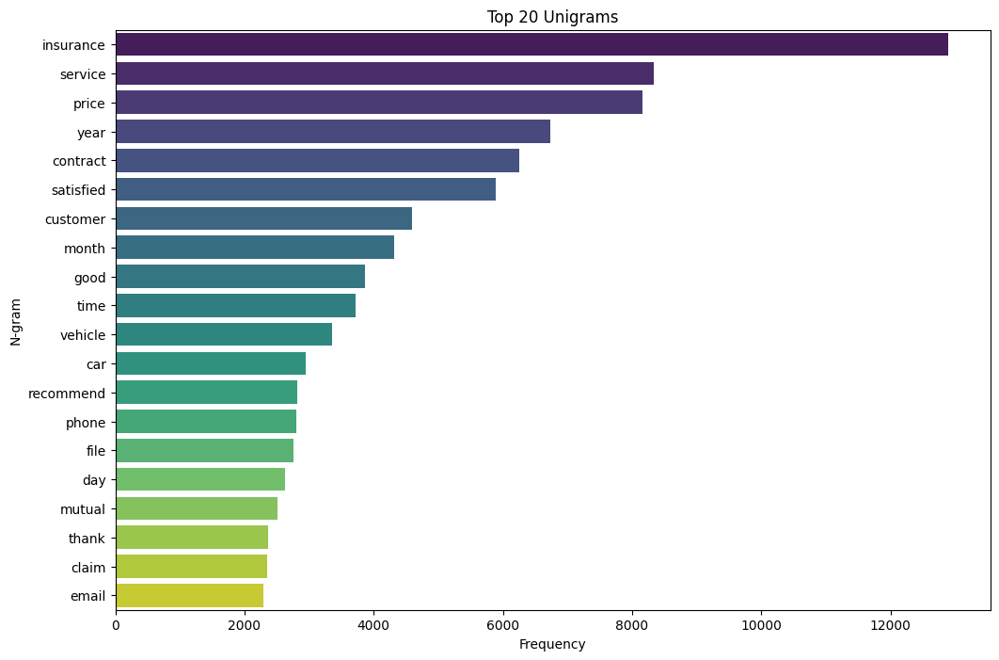

In [ ]:
# Plot unigrams
plot_ngrams(frequent_unigrams, 'Top 20 Unigrams')

<ipython-input-41-a777028f2b4e>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




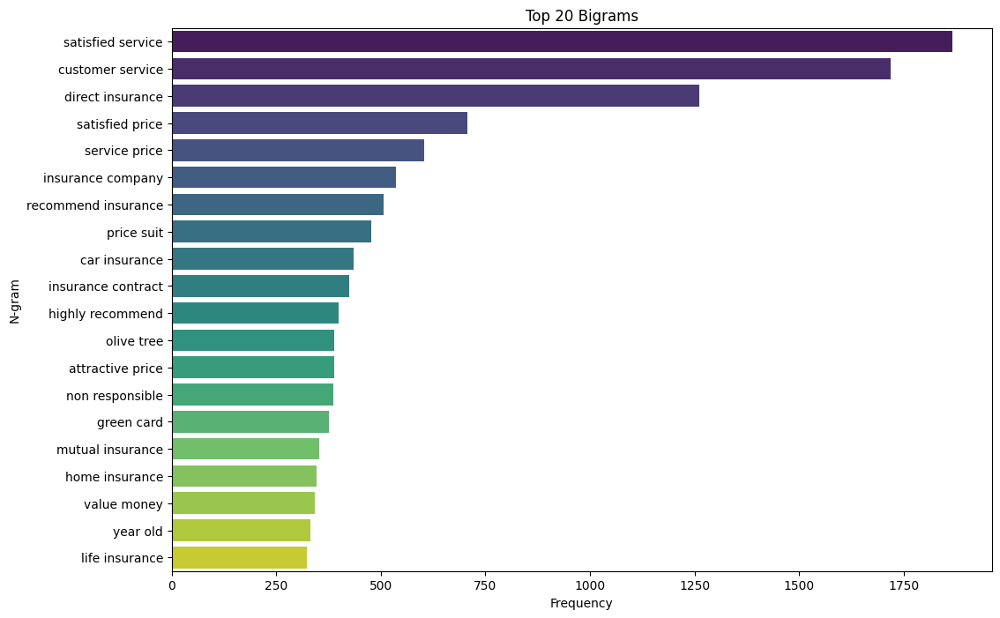

In [ ]:
# Plot bigrams
plot_ngrams(frequent_bigrams, 'Top 20 Bigrams')

 Zipf / Mandelbrot Law verification

In [ ]:
from collections import Counter

# Compter la fréquence des mots dans le corpus
word_frequencies = Counter([word for sentence in corpus for word in sentence])

# Obtenir les mots les plus fréquents et les moins utiles
most_frequent_words = word_frequencies.most_common(10)  # Les 10 mots les plus fréquents
least_frequent_words = [word for word, freq in word_frequencies.items() if freq == 1]

print("Most Frequent Words:", most_frequent_words)
print("Least Frequent Words:", least_frequent_words)

Most Frequent Words: [('insurance', 12896), ('service', 8336), ('price', 8163), ('year', 6740), ('contract', 6249), ('satisfied', 5884), ('customer', 4591), ('month', 4316), ('good', 3868), ('time', 3725)]
Least Frequent Words: []


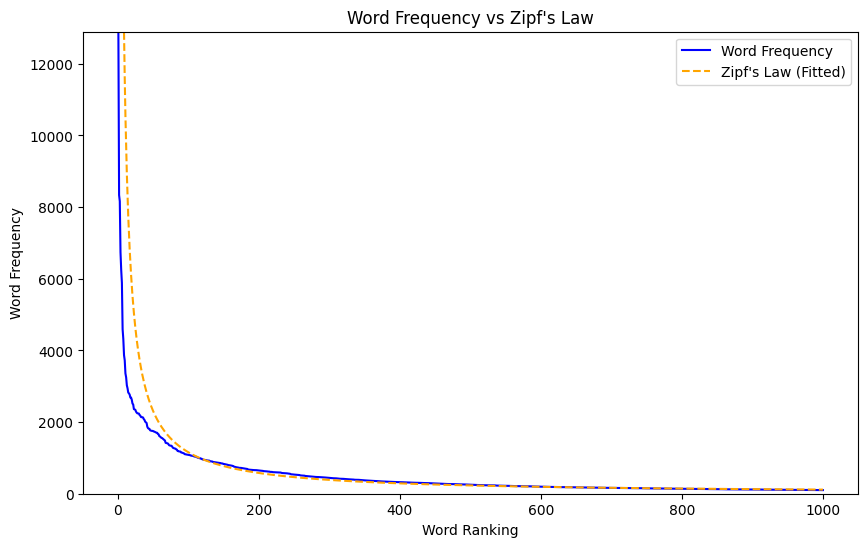

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Préparer les données
most_frequent_words = word_frequencies.most_common(1000)
most_frequent_words_count = np.array([most_frequent_words[i][1] for i in range(1000)])
word_ranking = np.arange(1, 1001)  # Classement des mots

# Transformer f(x) = a/x + b en g(x) = x * f(x) = a + b*x
g_x = word_ranking * most_frequent_words_count

# Régression linéaire avec scipy
slope, intercept, r_value, p_value, std_err = linregress(word_ranking, g_x)

# Récupérer les coefficients a et b
b = slope
a = intercept

# Définir la fonction de la loi de Zipf
def zipf_law(x):
    return a / x + b

# Calculer les valeurs prédites
zipf_law_count = zipf_law(word_ranking)

# Visualisation
plt.figure(figsize=(10, 6))
plt.plot(word_ranking, most_frequent_words_count, label="Word Frequency", color="blue")
plt.plot(word_ranking, zipf_law_count, label="Zipf's Law (Fitted)", color="orange", linestyle="--")
plt.xlabel("Word Ranking")
plt.ylabel("Word Frequency")
plt.ylim(0, most_frequent_words_count[0])
plt.title("Word Frequency vs Zipf's Law")
plt.legend()
plt.show()


Looking at more informative word with TF IDF

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Conversion du corpus en une liste de documents sous forme de chaînes
documents = [" ".join(words) for words in corpus]

# Étape 1 : Calculer les scores TF-IDF
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(documents)

# Obtenir les mots du vocabulaire
words = vectorizer.get_feature_names_out()

# Étape 2 : Identifier les mots les plus importants pour chaque document
important_words = {}
for idx, doc in enumerate(tfidf_matrix.toarray()):
    top_indices = doc.argsort()[-5:][::-1]  # Les 5 mots avec les scores les plus élevés
    important_words[f"Document {idx+1}"] = [(words[i], doc[i]) for i in top_indices]

# Étape 3 : Afficher les mots importants et leur contexte
print("Important Words and Contexts per Document:")
for idx, doc in enumerate(documents):
    print(f"\nDocument {idx+1}:")
    for word, score in important_words[f"Document {idx+1}"]:
        # Chercher le contexte des mots dans le document
        context = " ... ".join([sentence for sentence in doc.split(".") if word in sentence])
        print(f"  Word: {word}, Score: {score:.3f}, Context: {context}")


Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  Word: affordable, Score: 0.316, Context: satisfied price guarantee established view provident registered insurance practical young driver affordable highly recommend
  Word: registered, Score: 0.297, Context: satisfied price guarantee established view provident registered insurance practical young driver affordable highly recommend

Document 23389:
  Word: sincerely, Score: 0.409, Context: hello satisfied customer relation listening advice administrative order different type subscription sincerely
  Word: administrative, Score: 0.364, Context: hello satisfied customer relation listening advice administrative order different type subscription sincerely
  Word: type, Score: 0.349, Context: hello satisfied customer relation listening advice administrative order different type subscription sincerely
  Word: relation, Score: 0.338, Context: hello satisfied customer relation listening advice administrative order 

In [ ]:
!pip install pyLDAvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 73.1 MB/s eta 0:00:00


### **Topic Modeling and Lists of Topics: 2 points**

In [ ]:
data_train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24102 entries, 0 to 103
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   note              24102 non-null  float64
 1   auteur            24102 non-null  object 
 2   avis              24102 non-null  object 
 3   assureur          24102 non-null  object 
 4   produit           24102 non-null  object 
 5   date_publication  24102 non-null  object 
 6   date_exp          24102 non-null  object 
 7   avis_en           24102 non-null  object 
 8   tokenized_avis    24102 non-null  object 
dtypes: float64(1), object(8)
memory usage: 2.3+ MB


In [ ]:
!pip install

In [ ]:
import plotly.express as px
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
vectorizer = TfidfVectorizer(stop_words='english', max_features=1000)
X_tfidf = vectorizer.fit_transform(data_train['clean_text'])

num_topics = 5

# Train the LDA model
lda = LatentDirichletAllocation(n_components=num_topics, random_state=42)
lda.fit(X_tfidf)

# Function to extract the top words for each topic
def get_top_words(lda, vectorizer, n_words=10):
    words = vectorizer.get_feature_names_out()  # List of words in the vocabulary
    topic_data = []

    for topic_idx, topic in enumerate(lda.components_):
        # Get the indices of the top n_words for the current topic
        top_indices = topic.argsort()[:-n_words - 1:-1]

        # Get the corresponding words and their probabilities
        top_words = [words[i] for i in top_indices]
        top_probs = topic[top_indices]

        # Store topic words and probabilities in a dictionary for Plotly
        for word, prob in zip(top_words, top_probs):
            topic_data.append({
                'Topic': f'Topic {topic_idx + 1}',
                'Word': word,
                'Probability': prob
            })

    # Create a DataFrame for Plotly
    return pd.DataFrame(topic_data)

# Extract the top words for each topic
topic_words_df = get_top_words(lda, vectorizer, n_words=10)


# Plot the top words using Plotly (interactive)
fig = px.bar(topic_words_df,
             x='Probability',
             y='Word',
             color='Topic',
             orientation='h',  # Horizontal bar chart
             title='Top Words for Each Topic',
             labels={'Probability': 'Word Probability'},
             text='Probability',
             width=800,
             height=400)

# Show the interactive plot
fig.show()

In [ ]:
import gensim
from gensim import corpora
from gensim.models.ldamodel import LdaModel
import pyLDAvis.gensim_models
import matplotlib.pyplot as plt

# Prepare the corpus
corpus_tokens = data_train['tokenized_avis'].tolist()

# Create Dictionary
dictionary = corpora.Dictionary(corpus_tokens)

# Filter extremes to remove very rare and very common words
dictionary.filter_extremes(no_below=5, no_above=0.5)

# Create Corpus: Term Document Frequency
corpus = [dictionary.doc2bow(text) for text in corpus_tokens]

# Set parameters for LDA
num_topics = 5
passes = 10
random_state = 42

# Train LDA model
lda_model = LdaModel(corpus=corpus,
                     id2word=dictionary,
                     num_topics=num_topics,
                     random_state=random_state,
                     passes=passes,
                     alpha='auto',
                     per_word_topics=True)

# Print the topics
for idx, topic in lda_model.print_topics(-1):
    print(f"Topic: {idx}\nWords: {topic}\n")

# Visualize the topics using pyLDAvis
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, corpus, dictionary)
pyLDAvis.save_html(vis, 'lda_visualization.html')
print("LDA visualization saved as 'lda_visualization.html'.")

# Optional: Display pyLDAvis in Jupyter Notebook
pyLDAvis.display(vis)


Topic: 0
Words: 0.072*"loading" + 0.036*"service" + 0.030*"good" + 0.028*"satisfied" + 0.024*"recommend" + 0.020*"thank" + 0.017*"customer" + 0.017*"insurance" + 0.013*"advisor" + 0.013*"phone"

Topic: 1
Words: 0.049*"year" + 0.034*"insurance" + 0.021*"contract" + 0.014*"without" + 0.012*"increase" + 0.011*"euro" + 0.011*"customer" + 0.010*"home" + 0.010*"insurer" + 0.010*"claim"

Topic: 2
Words: 0.082*"price" + 0.044*"satisfied" + 0.043*"service" + 0.041*"insurance" + 0.021*"simple" + 0.015*"fast" + 0.013*"well" + 0.012*"see" + 0.012*"recommend" + 0.012*"easy"

Topic: 3
Words: 0.014*"month" + 0.011*"time" + 0.010*"contract" + 0.010*"mutual" + 0.010*"email" + 0.010*"insurance" + 0.010*"file" + 0.009*"service" + 0.009*"call" + 0.008*"since"

Topic: 4
Words: 0.019*"expert" + 0.018*"vehicle" + 0.015*"main" + 0.014*"insurance" + 0.011*"car" + 0.010*"claim" + 0.009*"disaster" + 0.009*"repair" + 0.009*"following" + 0.009*"accident"

LDA visualization saved as 'lda_visualization.html'.


In [ ]:
data_train = pd.read_pickle("/content/processed_data_train.pkl")

In [ ]:
corpus = data_train['tokenized_avis'].tolist()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# 4. Embedding to Identify Similar Words



1. **Word2Vec:**
    - Train a Word2Vec model specifically on your corpus for better contextual embedding. *(2 points)*



In [ ]:
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
# from gensim.downloader import api

# Convertir le modèle préchargé en format modifiable
# w2v = api.load('glove-twitter-50')
new_model = Word2Vec(vector_size=50, min_count=1)  # Assurez-vous que vector_size correspond
# new_model.build_vocab([list(w2v.key_to_index.keys())])  # Charger le vocabulaire existant
# new_model.wv.vectors = w2v.vectors  # Copier les vecteurs du modèle préchargé

# Ajouter le corpus et réentraîner
new_model.build_vocab(corpus) #, update=True)
new_model.train(corpus, total_examples=len(corpus), epochs=100)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


(55394670, 61332100)

In [ ]:
# Example: Most similar words to "insurance"
similar_words = new_model.wv.most_similar("insurance", topn=10)
print("Top 10 words similar to 'insurance':")
for word, score in similar_words:
    print(f"{word}: {score:.4f}")

Top 10 words similar to 'insurance':
assurance: 0.7184
insurer: 0.5669
newcomer: 0.5373
tree: 0.5251
ran: 0.5077
insured: 0.4993
debit: 0.4977
contract: 0.4555
hesitated: 0.4452
avanssur: 0.4420


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


2. **Encode Text Using Word2Vec:**
    - Convert text into vector representations using the fine-tuned Word2Vec model.


In [ ]:
def vectorize(sentence):
    res = np.zeros((50,))
    if len(sentence) >0 : res = new_model.wv[sentence]
    return res

data_train['vectorized_avis'] =  data_train['tokenized_avis'].apply(vectorize)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


3. **Implement Cosine Similarity:**
    - Compute cosine similarity between word embeddings and explain why it is a suitable distance metric. *(1 point)*


In [ ]:

def cosine_sim(x1, x2):
    return((x1 @ x2) / np.sqrt((x1.T @ x1)*(x2.T @ x2)))

a = np.array([0,1])
b = np.array([1,0])

print('Cosine sim of orthogonal vectors : ', cosine_sim(a,b))
print('Cosine sim of parallele vectors: ', cosine_sim(a, a * 10))
print('cosine_sim of combinaison of parallele and orthogonal vectors : ', cosine_sim(a, (a + b) / np.sqrt(2)))


Cosine sim of orthogonal vectors :  0.0
Cosine sim of parallele vectors:  1.0
cosine_sim of combinaison of parallele and orthogonal vectors :  0.7071067811865476


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Some studies highly the fact that word to vector embedding learned by LLM or W2V seems invariant to the norm. Wich mean that usually the word are embedded into vector dont change when multiply by a scalar, then the most important information for measuring their distance are the angle between to vectors.
For this reason we will implement distance using cosine similarity.

In [ ]:

def cosine_dist(x1, x2):
    return 1 -cosine_sim(x1, x2)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


4. **Clustering with K-Means:**
    - Apply k-means clustering to identify groups of semantically similar words.


In [ ]:
!python -m pip install --upgrade pip

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
#!pip install scikit-learn-extra


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
group_of_vectorized_word = []
group_of_words = []
for i,k in data_train[['vectorized_avis', 'tokenized_avis']].values :
    for j in range(len(i)):
        if len(i[j].shape) == 1 :
            group_of_vectorized_word += [i[j]]
            group_of_words += [k[j]]



group_of_vectorized_word = np.array(group_of_vectorized_word)[:2000]
group_of_words = group_of_words[:2000]

from sklearn_extra.cluster import KMedoids
from sklearn.metrics.pairwise import cosine_distances # Here we use the scipy definition of the cosine distance because it is implemented in c++

kmedoids = KMedoids(n_clusters=10, metric="precomputed", method='pam', )  # Utiliser une distance pré-calculée
distance_matrix = cosine_distances(group_of_vectorized_word)
labels = kmedoids.fit_predict(distance_matrix)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


5. **Visualize Word Similarity with t-SNE:**
    - Use t-SNE to project word embeddings into a 2D space for visualization of semantic relationships. *(1 point)*


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


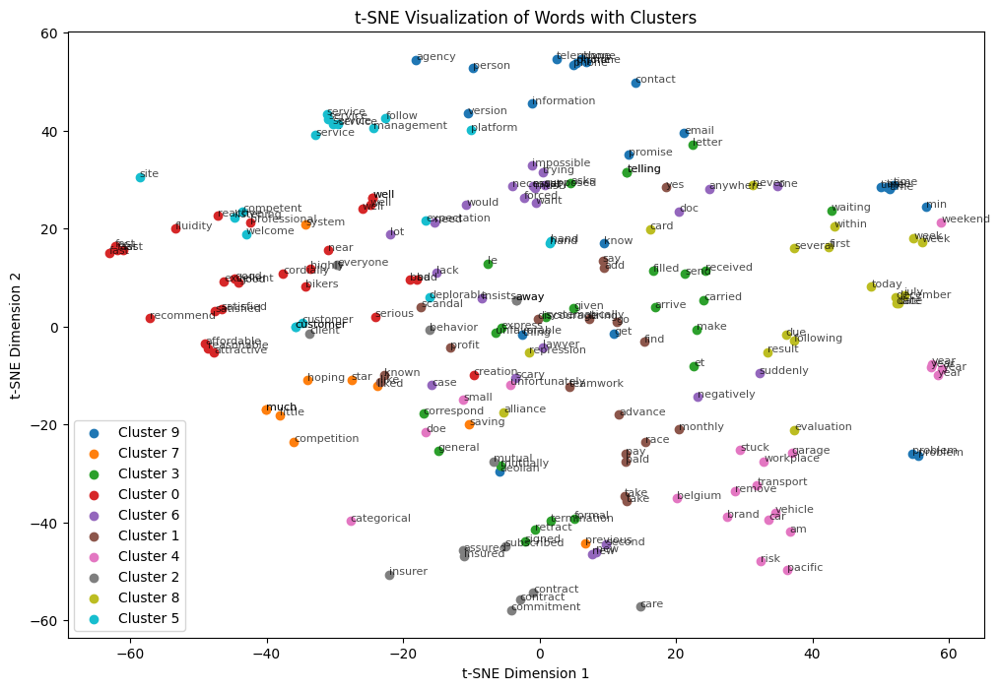

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# Étape 1 : Réduction de dimension avec t-SNE
tsne = TSNE(n_components=2, random_state=42, metric= cosine_dist)
tsne_vectors = tsne.fit_transform(group_of_vectorized_word)

# Étape 2 : Création d'un DataFrame pour les mots, vecteurs t-SNE et clusters
temp_data = pd.DataFrame({
    'words': group_of_words,  # Liste des mots
    'tsne_x': tsne_vectors[:, 0],  # Coordonnée x des vecteurs t-SNE
    'tsne_y': tsne_vectors[:, 1],  # Coordonnée y des vecteurs t-SNE
    'cluster': labels  # Clusters associés
})

# Étape 3 : Échantillonner 200 mots pour l'affichage
sample = temp_data.sample(200, random_state=42)

# Étape 4 : Visualisation
plt.figure(figsize=(12, 8))

# Afficher les points en fonction des clusters
for cluster in sample['cluster'].unique():
    cluster_data = sample[sample['cluster'] == cluster]
    plt.scatter(cluster_data['tsne_x'], cluster_data['tsne_y'], label=f"Cluster {cluster}")

# Annoter les mots
for _, row in sample.iterrows():
    plt.annotate(row['words'], (row['tsne_x'], row['tsne_y']), fontsize=8, alpha=0.7)

# Paramètres de graphique
plt.title("t-SNE Visualization of Words with Clusters")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend()
plt.show()


Here, we can truly appreciate the power of word vectorization and how it allows us to leverage linguistic information using mathematical tools. The chosen distance metric (cosine similarity) faithfully represents the semantic distances between words. For example, we can observe that words like **'contract'** and **'commitment'** are very close to each other at the bottom of the graph. Similarly, words such as **'car'**, **'vehicle'**, and **'transport'** form a tight cluster, reflecting their semantic relationship related to automobiles and mobility. Another example includes **'customer'**, **'client'**, and **'service'**, which are grouped based on their association with business and professional contexts.

t-SNE provides a useful visualization, especially for words with very similar meanings, as it preserves similarity in the reduced-dimensional space. This clustering not only highlights semantic relationships but also demonstrates the effectiveness of word embeddings in capturing contextual meanings, making them valuable tools for tasks like information retrieval, sentiment analysis, and recommendation systems.

In [ ]:
def cosine_similarity(vec_a, vec_b):
    """
    Compute the cosine similarity between two vectors.
    """
    dot_product = np.dot(vec_a, vec_b)
    norm_a = np.linalg.norm(vec_a)
    norm_b = np.linalg.norm(vec_b)
    return dot_product / (norm_a * norm_b + 1e-10)  # Avoid division by zero
def get_document_embedding(tokens, model):
    """
    Compute a document embedding by averaging word vectors.
    """
    valid_vectors = []
    for token in tokens:
        if token in model.wv:
            valid_vectors.append(model.wv[token])
    if not valid_vectors:
        # If no valid token found, return a zero vector
        return np.zeros(model.vector_size)
    return np.mean(valid_vectors, axis=0)

# Build embeddings for each review in data_train
doc_embeddings = []
for idx, tokens in enumerate(corpus):
    embedding = get_document_embedding(tokens, new_model)
    doc_embeddings.append(embedding)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
data_train.reset_index(drop=True, inplace=True)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def semantic_search(query, model, doc_embeddings, top_k=3):
    """
    Given a query, compute similarity scores with all documents,
    and return the top_k most similar documents (by cosine similarity).
    """
    # Tokenize & embed the query
    query_tokens = query.lower().split()  # or use your pipeline's tokenizer
    query_embedding = get_document_embedding(query_tokens, model)

    # Compute similarities
    similarities = []
    for idx, doc_vec in enumerate(doc_embeddings):
        cos_sim = cosine_similarity(query_embedding, doc_vec)
        similarities.append((idx, cos_sim))

    # Sort by descending similarity
    similarities.sort(key=lambda x: x[1], reverse=True)

    # Return top_k results
    return similarities[:top_k]

# Example usage
user_query = "looking for affordable insurance"
results = semantic_search(user_query, new_model, doc_embeddings, top_k=3)

print(f"Top documents for query: '{user_query}'")
for idx, sim in results:
    print(f"Document Index: {idx}, Similarity: {sim:.4f}")
    print("Original Text:", data_train.loc[idx, 'avis_en'])
    print("Tokenized  :", data_train.loc[idx, 'tokenized_avis'])
    print("-"*50)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Top documents for query: 'looking for affordable insurance'
Document Index: 2528, Similarity: 0.8222
Original Text: For a young driver I find that prices and services give by Olivier Insurance are really good. I strongly recommend this asurance to Direct Insurance which offers the same services but more expensive.
Tokenized  : ['young', 'driver', 'find', 'price', 'service', 'give', 'olivier', 'insurance', 'really', 'good', 'strongly', 'recommend', 'assurance', 'direct', 'insurance', 'offer', 'service', 'expensive']
--------------------------------------------------
Document Index: 21559, Similarity: 0.8140
Original Text: Listening people.
After looking for other insurers. The prices are competitive.
The contracts are clear ...
I recommend AMV insurance to those around me.

Tokenized  : ['listening', 'people', 'looking', 'insurer', 'price', 'competitive', 'contract', 'clear', 'recommend', 'am', 'insurance', 'around']
--------------------------------------------------
Document Index: 493

In [ ]:
data_train.head()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,note,auteur,avis,assureur,produit,date_publication,date_exp,avis_en,tokenized_avis,vectorized_avis
0,5.0,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute,...",Direct Assurance,auto,06/09/2021,01/09/2021,"Best insurance, price, solutions, listening, s...","[best, insurance, price, solution, listening, ...","[[-1.4601188, 2.0669553, 1.9551934, 0.81243867..."
1,4.0,bernard-g-112497,"je suis globalement satisfait , sauf que vous ...",Direct Assurance,auto,03/05/2021,01/05/2021,"I am generally satisfied, except that you have...","[generally, satisfied, except, problem, websit...","[[-3.3180485, 1.6742252, -2.7432902, 0.9348561..."
2,5.0,virginie-t-107352,Prix tres abordable plusieurs options s'offren...,Direct Assurance,auto,21/03/2021,01/03/2021,Very affordable price Several options are avai...,"[affordable, price, several, option, available...","[[-3.5927904, 3.1882577, -1.808566, 1.7000738,..."
3,4.0,boulain-f-116580,"je satisfait du service, une réponse très rapi...",L'olivier Assurance,auto,10/06/2021,01/06/2021,"I satisfy the service, a very fast response fr...","[satisfy, service, fast, response, service, th...","[[-2.4123843, 2.0062819, 0.6898765, 0.52028584..."
4,1.0,ouaille31-51798,"Client depuis plus de 25 ans, très déçu de cet...",Matmut,auto,29/01/2017,01/01/2017,"Customer for more than 25 years, very disappoi...","[customer, year, disappointed, mutual, longer,...","[[-3.0274696, -0.73209673, 2.188643, -1.599053..."


# Supervised Learning

In [ ]:
data_train = pd.read_pickle("/content/processed_data_train.pkl")

In [ ]:
from collections import defaultdict
word_freq = defaultdict(int)
for tokens in data_train['tokenized_avis']:
    for token in tokens:
        word_freq[token] += 1

In [ ]:
data_train.head()

,note,auteur,avis,assureur,produit,date_publication,date_exp,avis_en,tokenized_avis
0,5.0,brahim--k-131532,"Meilleurs assurances, prix, solutions, écoute,...",Direct Assurance,auto,06/09/2021,01/09/2021,"Best insurance, price, solutions, listening, s...","[best, insurance, price, solution, listening, ..."
1,4.0,bernard-g-112497,"je suis globalement satisfait , sauf que vous ...",Direct Assurance,auto,03/05/2021,01/05/2021,"I am generally satisfied, except that you have...","[generally, satisfied, except, problem, websit..."
2,5.0,virginie-t-107352,Prix tres abordable plusieurs options s'offren...,Direct Assurance,auto,21/03/2021,01/03/2021,Very affordable price Several options are avai...,"[affordable, price, several, option, available..."
3,4.0,boulain-f-116580,"je satisfait du service, une réponse très rapi...",L'olivier Assurance,auto,10/06/2021,01/06/2021,"I satisfy the service, a very fast response fr...","[satisfy, service, fast, response, service, th..."
4,1.0,ouaille31-51798,"Client depuis plus de 25 ans, très déçu de cet...",Matmut,auto,29/01/2017,01/01/2017,"Customer for more than 25 years, very disappoi...","[customer, year, disappointed, mutual, longer,..."


In [ ]:
data_train['clean_text'] = data_train['tokenized_avis'].apply(lambda tokens: ' '.join(tokens))


### TF-IDF + Classical ML (Baseline)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Logistic Regression -> Accuracy: 0.5148, F1: 0.4813


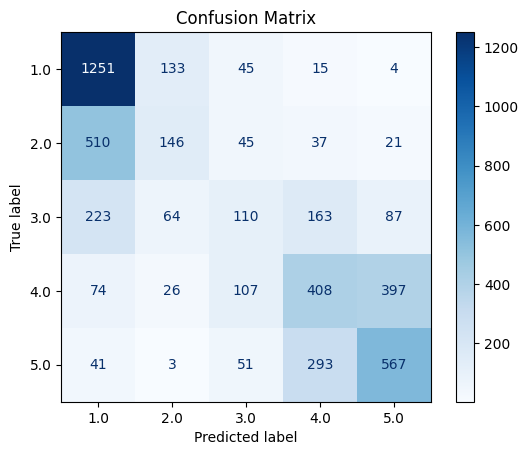

Classification Report:
              precision    recall  f1-score   support

         1.0       0.60      0.86      0.71      1448
         2.0       0.39      0.19      0.26       759
         3.0       0.31      0.17      0.22       647
         4.0       0.45      0.40      0.42      1012
         5.0       0.53      0.59      0.56       955

    accuracy                           0.51      4821
   macro avg       0.45      0.44      0.43      4821
weighted avg       0.48      0.51      0.48      4821



In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# 1. TF-IDF
tfidf = TfidfVectorizer()
X_tfidf = tfidf.fit_transform(data_train['clean_text'])

# 2. Split
X_train, X_test, y_train, y_test = train_test_split(X_tfidf, data_train['note'], test_size=0.2, random_state=42)

# 3. Train
clf = LogisticRegression()
clf.fit(X_train, y_train)

# 4. Evaluate
y_pred = clf.predict(X_test)
acc = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print(f"Logistic Regression -> Accuracy: {acc:.4f}, F1: {f1:.4f}")

# 5. Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

# 6. Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:")
print(report)


### Basic model with an embedding layer

In [ ]:
import pandas as pd
path = "/content/drive/MyDrive/projet_2_NLP/processed_data_train.pkl"
#import drive
from google.colab import drive
drive.mount('/content/drive')
data_train = pd.read_pickle(path)
data_train['clean_text'] = data_train['tokenized_avis'].apply(lambda tokens: ' '.join(tokens))

Mounted at /content/drive


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


Epoch 1/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 12s 11ms/step - accuracy: 0.3558 - loss: 1.5211 - val_accuracy: 0.4848 - val_loss: 1.2089
Epoch 2/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.4834 - loss: 1.1806 - val_accuracy: 0.5007 - val_loss: 1.1243
Epoch 3/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.4997 - loss: 1.1213 - val_accuracy: 0.5040 - val_loss: 1.0955
Epoch 4/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.5080 - loss: 1.0880 - val_accuracy: 0.5094 - val_loss: 1.0841
Epoch 5/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.5225 - loss: 1.0544 - val_accuracy: 0.5163 - val_loss: 1.0872
Epoch 6/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 0.5279 - loss: 1.0400 - val_accuracy: 0.4964 - val_loss: 1.1173
Epoch 7/20
603/603 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.5508 - loss: 1.0119 - val_accuracy: 0.5144 - val_loss: 1.0968
151/151 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.5158 - loss: 1.0781
Basic Embedding Model -> Ac

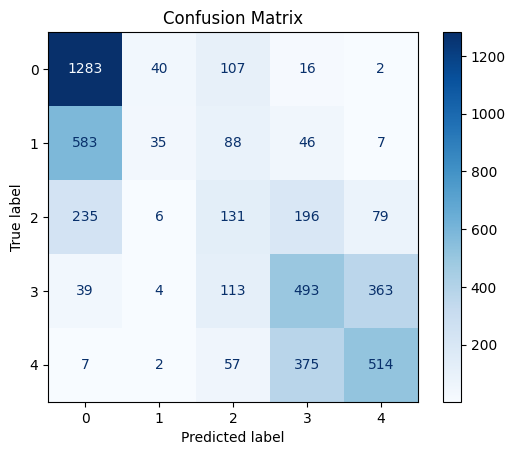

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, GlobalAveragePooling1D, Dense
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, f1_score
import matplotlib.pyplot as plt

# 1. Tokenizer
tokenizer = Tokenizer(num_words=10000, oov_token='<OOV>')
tokenizer.fit_on_texts(data_train['clean_text'])
X_seq = tokenizer.texts_to_sequences(data_train['clean_text'])
X_padded = pad_sequences(X_seq, maxlen=100, padding='post')
y = data_train['note'].astype(int)

# 2. Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(X_padded, y, test_size=0.2, random_state=42)

# 3. Basic Model
model = Sequential([
    Embedding(input_dim=10000, output_dim=64, input_length=100, name='embedding_layer'),
    GlobalAveragePooling1D(),
    Dense(32, activation='relu'),
    Dense(6, activation='softmax')  # If note is 1-5, use 6 to have index 0 unused or map 1–5 to 0–4
])

model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Early Stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True)

model.fit(X_train, y_train, epochs=20, validation_data=(X_test, y_test), callbacks=[early_stopping])

# Evaluate
loss, accuracy = model.evaluate(X_test, y_test)
print(f"Basic Embedding Model -> Accuracy: {accuracy:.4f}")

# Predictions
y_pred = model.predict(X_test)
y_pred_classes = tf.argmax(y_pred, axis=1).numpy()

# F1 Score
f1 = f1_score(y_test, y_pred_classes, average='weighted')
print(f"F1 Score: {f1:.4f}")

# Classification Report
report = classification_report(y_test, y_pred_classes)
print("Classification Report:")
print(report)

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred_classes)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

Shap analysis

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


  0%|          | 0/1 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step


Text(0.5, 1.0, 'SHAP Feature Importance')

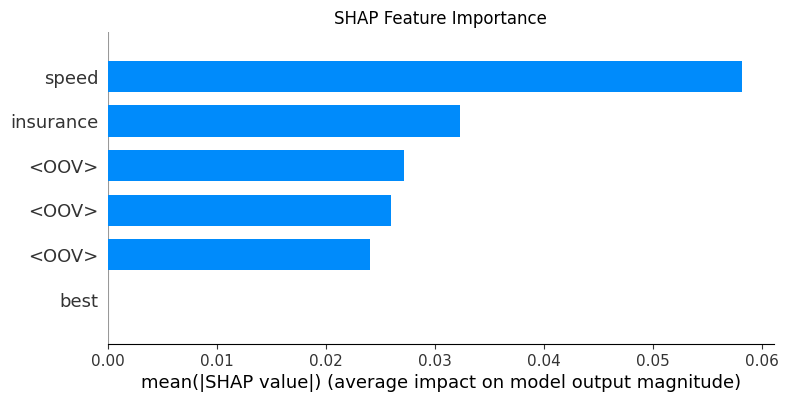

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt

text = "Best insurance, prices, solutions, attentiveness, speed, and I recommend this company for you Attractive prices and quality and speed services"
text_seq = tokenizer.texts_to_sequences([text])  # Tokenisation
text_padded = pad_sequences(text_seq, maxlen=100, padding='post')  # Padding

# Fonction de prédiction adaptée pour SHAP
def predict_proba(padded_texts):
    """
    Fonction pour générer des prédictions basées sur le modèle.
    """
    return model.predict(padded_texts)  # Retourne des probabilités (shape: [n_samples, n_classes])

# Création de l'explainer SHAP avec KernelExplainer
explainer = shap.KernelExplainer(
    predict_proba,
    np.zeros((1, text_padded.shape[1]))  # Une séquence de base remplie de zéros
)

# Calcul des valeurs SHAP
shap_values = explainer.shap_values(text_padded)

# Extraction des mots importants (ignorer "<OOV>")
sequence_words = [tokenizer.index_word.get(idx, None) for idx in text_seq[0] if idx != 0]
shap_importances = shap_values[0][0][:len(sequence_words)]  # Valeurs SHAP pour les mots
word_importance_pairs = list(zip(sequence_words, shap_importances))

# Filtrer pour exclure les mots "None" (correspondant à <OOV>)
filtered_pairs = [(word, importance) for word, importance in word_importance_pairs if word is not None]

# Trie les mots par importance
sorted_importance = sorted(filtered_pairs, key=lambda x: abs(x[1]), reverse=True)


# Préparer les données pour le graphique SHAP
words, importances = zip(*filtered_pairs)
shap_matrix = np.array([importances])  # Ajouter une dimension pour représenter un seul exemple

# Visualisation des importances avec SHAP bar_plot
plt.figure(figsize=(8, 6))
shap.summary_plot(
    shap_matrix,  # Matrice des valeurs SHAP (1, n_features)
    feature_names=words,  # Les mots correspondants
    plot_type="bar",  # Type de graphique : bar
    show=False
)
plt.title("SHAP Feature Importance")

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, GlobalAveragePooling1D, Dense
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, f1_score
import matplotlib.pyplot as plt
import numpy as np
import os

In [ ]:
import os
import tensorflow as tf
from tensorboard.plugins import projector

# 4. Extract the learned embedding weights
embedding_layer = model.get_layer('embedding_layer')
embedding_weights = embedding_layer.get_weights()[0]  # shape = (10000, 64)

# Create a subset of the vocabulary for clearer visualization
VOCAB_SIZE_TO_VISUALIZE = 2000
embedding_subset = embedding_weights[:VOCAB_SIZE_TO_VISUALIZE]
print("Subset shape for visualization:", embedding_subset.shape)

# Create a TensorFlow variable
embedding_var = tf.Variable(embedding_subset, name='embedding_var')

# 5. Create log directory for projector
projector_log_dir = "/content/logs/embedding_projector"  # Updated path for Colab
os.makedirs(projector_log_dir, exist_ok=True)

# 6. Save a checkpoint
checkpoint = tf.train.Checkpoint(embedding=embedding_var)
checkpoint.save(os.path.join(projector_log_dir, "embedding.ckpt"))

# 7. Create metadata file with word indices
metadata_file = os.path.join(projector_log_dir, "metadata.tsv")
index_word = tokenizer.index_word  # dict {index: word}

with open(metadata_file, "w", encoding="utf-8") as f:
    f.write("word\n")
    for i in range(1, VOCAB_SIZE_TO_VISUALIZE):
        if i in index_word:
            f.write(f"{index_word[i]}\n")
        else:
            f.write("?\n")

# 8. Configure the Projector using TensorBoard Plugins
config = projector.ProjectorConfig()
embedding_conf = config.embeddings.add()
embedding_conf.tensor_name = "embedding_var"
embedding_conf.metadata_path = os.path.basename(metadata_file)  # Fixed path

# Save the configuration file
projector.visualize_embeddings(projector_log_dir, config)
print(f"Projector config saved to {projector_log_dir}")

# 9. Generate an event file for TensorBoard
summary_writer = tf.summary.create_file_writer(projector_log_dir)
with summary_writer.as_default():
    tf.summary.scalar('dummy_scalar', 0, step=0)  # Create an event file

# 10. Launch TensorBoard
print(f"\nTo visualize embeddings, run:\n\n%tensorboard --logdir {projector_log_dir}\n")

Subset shape for visualization: (2000, 64)
Projector config saved to /content/logs/embedding_projector

To visualize embeddings, run:

%tensorboard --logdir /content/logs/embedding_projector



In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/logs/embedding_projector

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 40073), started 0:00:30 ago. (Use '!kill 40073' to kill it.)

<IPython.core.display.Javascript object>

### Model with pre-trained embeddings

In [ ]:
import gensim.downloader as api

# Loads the Google News Word2Vec (300-dimensional)
pretrained_w2v = api.load("word2vec-google-news-300")

# 'pretrained_w2v' is a KeyedVectors instance


In [ ]:
import numpy as np

def vectorize(tokens, model):
    """
    Convert a list of tokens into a single embedding vector
    by averaging the pre-trained Word2Vec embeddings.
    """
    valid_embeddings = []
    for token in tokens:
        if token in model:
            valid_embeddings.append(model[token])

    if not valid_embeddings:
        return np.zeros(model.vector_size, dtype=np.float32)

    return np.mean(valid_embeddings, axis=0)

# Assuming data_train['tokenized_avis'] exists
data_train['vectorized_avis'] = data_train['tokenized_avis'].apply(lambda toks: vectorize(toks, pretrained_w2v))


In [ ]:
print(data_train['vectorized_avis'].head())

# Example check
some_vector = data_train['vectorized_avis'].iloc[0]
print("Vector shape:", some_vector.shape)  # Should be (300,)
print("First 10 dims:", some_vector[:10])

0    [-0.00068547175, 0.037053034, 0.052659255, 0.0...
1    [0.045434248, -0.019068668, -0.050544336, 0.07...
2    [0.05206197, -0.0013753255, -0.029748535, 0.12...
3    [-0.036289595, -0.034924317, 0.02836914, 0.116...
4    [0.016973266, 0.036463622, 0.003040619, 0.0812...
Name: vectorized_avis, dtype: object
Vector shape: (300,)
First 10 dims: [-0.00068547  0.03705303  0.05265925  0.0872075  -0.00704252  0.01811101
  0.1308406  -0.00596853  0.13390644  0.10464712]


RandomForest -> Accuracy: 0.4779, F1: 0.4074
Classification Report:
              precision    recall  f1-score   support

         1.0       0.52      0.91      0.67      1448
         2.0       0.28      0.04      0.07       759
         3.0       0.26      0.05      0.08       647
         4.0       0.41      0.40      0.40      1012
         5.0       0.48      0.55      0.51       955

    accuracy                           0.48      4821
   macro avg       0.39      0.39      0.35      4821
weighted avg       0.42      0.48      0.41      4821



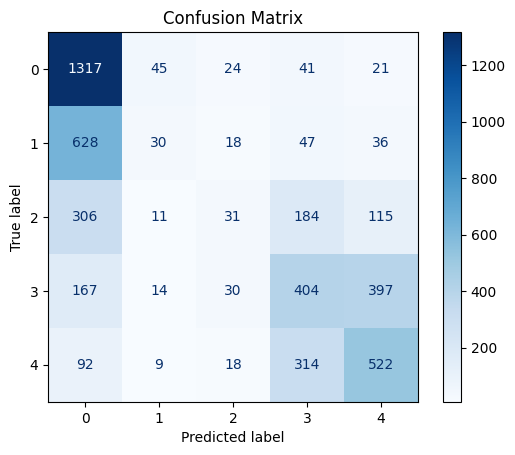

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import numpy as np
import matplotlib.pyplot as plt

X = np.vstack(data_train['vectorized_avis'].values)  # shape: (num_samples, 300)
y = data_train['note']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
clf = RandomForestClassifier()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
acc = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print(f"RandomForest -> Accuracy: {acc:.4f}, F1: {f1:.4f}")

# Classification Report
report = classification_report(y_test, y_pred)
print("Classification Report:")
print(report)

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
!pip uninstall tensorboard
!pip install tensorboard

Found existing installation: tensorboard 2.7.0
Uninstalling tensorboard-2.7.0:
  Would remove:
    /usr/local/bin/tensorboard
    /usr/local/lib/python3.10/dist-packages/tensorboard-2.7.0.dist-info/*
    /usr/local/lib/python3.10/dist-packages/tensorboard/*
Proceed (Y/n)? Y
  Successfully uninstalled tensorboard-2.7.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 59.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 68.7 MB/s eta 0:00:00
  Attempting uninstall: tensorboard-data-server
    Found existing installation: tensorboard-data-server 0.6.1
    Uninstalling tensorboard-data-server-0.6.1:
      Successfully uninstalled tensorboard-data-server-0.6.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.17.1 requires tensorboard<2.18,>=2.17, but you have tensorboard 2.18.0 which is incompatible.


In [ ]:
import tensorflow as tf
import numpy as np
import os
from tensorboard.plugins import projector

##############################################################################
#              2.1. Build a Subset of Tokens from Your Data                  #
##############################################################################

# Collect all unique tokens from the dataset
unique_tokens = set()
for tokens in data_train['tokenized_avis']:
    unique_tokens.update(tokens)
unique_tokens = list(unique_tokens)

# For clarity, let's limit to top 2000 tokens or so
MAX_VOCAB = 2000
tokens_subset = unique_tokens[:MAX_VOCAB]

##############################################################################
#     2.2. Retrieve Word2Vec Vectors for Those Tokens (if in Model Vocab)    #
##############################################################################

embedding_dim = pretrained_w2v.vector_size  # should be 300
embedding_list = []
valid_token_list = []

for t in tokens_subset:
    if t in pretrained_w2v:
        embedding_list.append(pretrained_w2v[t])
        valid_token_list.append(t)

# Convert to a numpy array
embedding_array = np.array(embedding_list)  # shape: (num_valid_tokens, 300)
print("embedding_array shape:", embedding_array.shape)

##############################################################################
#     2.3. Create a TensorFlow Variable and Save Checkpoint for Projector     #
##############################################################################

# Turn these embeddings into a TF Variable
embedding_var = tf.Variable(embedding_array, name='w2v_projector')

# Directory for logs
projector_log_dir = "logs/w2v_projector"
os.makedirs(projector_log_dir, exist_ok=True)

# Create a checkpoint
checkpoint = tf.train.Checkpoint(embedding=embedding_var)
checkpoint.save(os.path.join(projector_log_dir, "embedding.ckpt"))

# Create a metadata file
metadata_file = os.path.join(projector_log_dir, "metadata.tsv")
with open(metadata_file, "w", encoding="utf-8") as f:
    f.write("token\n")
    for token in valid_token_list:
        f.write(f"{token}\n")

##############################################################################
#     2.4. Create Projector Config                                           #
##############################################################################

# Configure projector
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = embedding_var.name
embedding.metadata_path = "metadata.tsv"

# Save the configuration to the log directory
projector.visualize_embeddings(projector_log_dir, config)

##############################################################################
#     2.5. Add a SummaryWriter (Important for TensorBoard)                   #
##############################################################################

# Create a SummaryWriter
writer = tf.summary.create_file_writer(projector_log_dir)

# Write the embeddings to event logs
with writer.as_default():
    tf.summary.scalar('test_scalar', 0, step=0)  # Dummy scalar to activate TensorBoard
    writer.flush()

print(f"\nTo visualize embeddings, run:\n\ntensorboard --logdir={projector_log_dir}\n")
print("Open the 'Projector' tab and explore the embeddings.")

embedding_array shape: (1960, 300)

To visualize embeddings, run:

tensorboard --logdir=logs/w2v_projector

Open the 'Projector' tab and explore the embeddings.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/w2v_projector

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 29610), started 0:09:06 ago. (Use '!kill 29610' to kill it.)

<IPython.core.display.Javascript object>

We need to downgrade to tf 2.16 to use the earlystopping with the last verison of transformers

In [ ]:
!pip install tensorflow==2.16.1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 75.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 81.8 MB/s eta 0:00:00
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfully uninstalled ml-dtypes-0.4.1
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.17.1
    Uninstalling tensorboard-2.17.1:
      Successfully uninstalled tensorboard-2.17.1
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.17.1
    Uninstalling tensorflow-2.17.1:
      Successfully uninstalled tensorflow-2.17.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.16.1 w

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
data_train = pd.read_pickle("/content/processed_data_train.pkl")

In [ ]:
from collections import defaultdict
word_freq = defaultdict(int)
for tokens in data_train['tokenized_avis']:
    for token in tokens:
        word_freq[token] += 1

In [ ]:
data_train['clean_text'] = data_train['tokenized_avis'].apply(lambda tokens: ' '.join(tokens))


### Electra

Num GPUs Available:  1
   note             auteur                                               avis  \
0   5.0   brahim--k-131532  Meilleurs assurances, prix, solutions, écoute,...   
1   4.0   bernard-g-112497  je suis globalement satisfait , sauf que vous ...   
2   5.0  virginie-t-107352  Prix tres abordable plusieurs options s'offren...   
3   4.0   boulain-f-116580  je satisfait du service, une réponse très rapi...   
4   1.0    ouaille31-51798  Client depuis plus de 25 ans, très déçu de cet...   

              assureur produit date_publication    date_exp  \
0     Direct Assurance    auto       06/09/2021  01/09/2021   
1     Direct Assurance    auto       03/05/2021  01/05/2021   
2     Direct Assurance    auto       21/03/2021  01/03/2021   
3  L'olivier Assurance    auto       10/06/2021  01/06/2021   
4               Matmut    auto       29/01/2017  01/01/2017   

                                             avis_en  \
0  Best insurance, price, solutions, listening, s...   

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some layers from the model checkpoint at google/electra-base-discriminator were not used when initializing TFElectraForSequenceClassification: ['discriminator_predictions']
- This IS expected if you are initializing TFElectraForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFElectra

Model: "tf_electra_for_sequence_classification"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 electra (TFElectraMainLaye  multiple                  108891648 
 r)                                                              
                                                                 
 classifier (TFElectraClass  multiple                  594437    
 ificationHead)                                                  
                                                                 
Total params: 109486085 (417.66 MB)
Trainable params: 109486085 (417.66 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/3


Cause: for/else statement not yet supported
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Cause: for/else statement not yet supported
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
1206/1206 [==============================] - 627s 456ms/step - loss: 1.5813 - accuracy: 0.2968 - val_loss: 1.6000 - val_accuracy: 0.2099
Epoch 2/3
1206/1206 [==============================] - 536s 444ms/step - loss: 1.5745 - accuracy: 0.3005 - val_loss: 1.5720 - val_accuracy: 0.3004
Epoch 3/3
302/302 [==============================] - 43s 142ms/step - loss: 1.5718 - accuracy: 0.3004

Test Loss: 1.5718, Test Accuracy: 0.3004
302/302 [==============================] - 50s 139ms/step
Accuracy: 0.3004, F1 Score: 0.1387
Classification Report:
              precision    recall  f1-score   support

           1       0.30      1.00      0.46      1448
           2       0.00      0.00      0.00       759
           3       0.00      0.00      0.00       647
           4       0.00      0.00      0.00      1012
           5       0.00      0.00      0.00    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


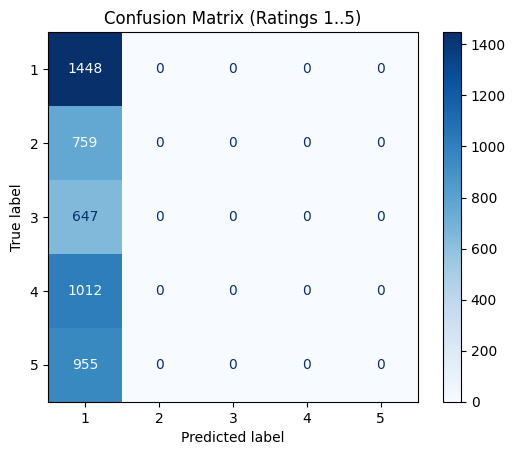

In [ ]:
# Import libraries
import numpy as np
import pandas as pd
import tensorflow as tf
from transformers import AutoTokenizer, TFAutoModelForSequenceClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import os

# Check GPU availability
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# Assume data_train is already loaded with columns 'clean_text' and 'note'
# Example:
# data_train = pd.read_csv('your_data.csv')  # Replace with your data loading method

# Display first few rows of data_train for verification
print(data_train.head())

# Prepare labels (adjust labels from 1-5 to 0-4)
X_text = data_train['clean_text'].tolist()
y_labels = (data_train['note'].astype(int) - 1).values  # Ratings 0-4

# Verify unique labels
print("Unique rating values:", np.unique(y_labels))  # Should be [0, 1, 2, 3, 4]

# Train/Test Split
X_train_texts, X_test_texts, y_train, y_test = train_test_split(
    X_text, y_labels, test_size=0.2, random_state=42
)
print(f"Train size: {len(X_train_texts)}, Test size: {len(X_test_texts)}")

# Load a different model from Hugging Face (Electra)
model_name = "google/electra-base-discriminator"
num_labels = 5  # Labels 0-4

# Initialize tokenizer
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize the text data
max_length = 128
train_encodings = tokenizer(
    X_train_texts, truncation=True, padding=True, max_length=max_length
)
test_encodings = tokenizer(
    X_test_texts, truncation=True, padding=True, max_length=max_length
)

# Create TensorFlow datasets
train_dataset = tf.data.Dataset.from_tensor_slices((
    dict(train_encodings),
    y_train
))
test_dataset = tf.data.Dataset.from_tensor_slices((
    dict(test_encodings),
    y_test
))

batch_size = 16
train_dataset = train_dataset.shuffle(buffer_size=1000).batch(batch_size)
test_dataset = test_dataset.batch(batch_size)

# Load Electra model for sequence classification
model = TFAutoModelForSequenceClassification.from_pretrained(
    model_name,
    num_labels=num_labels
)

# Compile the model with a standard loss function
model.compile(
    optimizer="adam",
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"]
)

# Display model summary
model.summary()

# Set up TensorBoard callback
log_dir = "logs/electra_classification"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

# Early Stopping callback to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

# Train the model
epochs = 3
history = model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=epochs,
    callbacks=[early_stopping, tensorboard_callback]
)

# Evaluate the model on test dataset
results = model.evaluate(test_dataset)
print(f"\nTest Loss: {results[0]:.4f}, Test Accuracy: {results[1]:.4f}")

# Make predictions on test dataset
pred_logits = model.predict(test_dataset).logits
y_pred = np.argmax(pred_logits, axis=1)  # Predictions in [0, 1, 2, 3, 4]

# Adjust predictions: if needed, map back to original labels
y_pred_final = y_pred + 1  # Now in [1, 2, 3, 4, 5]
y_test_final = y_test + 1  # Ensure y_test is also in [1, 2, 3, 4, 5]

# Evaluation Metrics
acc = accuracy_score(y_test_final, y_pred_final)
f1 = f1_score(y_test_final, y_pred_final, average='weighted')
print(f"Accuracy: {acc:.4f}, F1 Score: {f1:.4f}")

# Classification Report
report = classification_report(
    y_test_final, y_pred_final,
    labels=[1,2,3,4,5],
    target_names=["1","2","3","4","5"]
)
print("Classification Report:")
print(report)

# Confusion Matrix
cm = confusion_matrix(y_test_final, y_pred_final, labels=[1,2,3,4,5])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["1","2","3","4","5"])
disp.plot(cmap='Blues')
plt.title("Confusion Matrix (Ratings 1..5)")
plt.show()

### RoBERTa

Num GPUs Available:  1
   note             auteur                                               avis  \
0   5.0   brahim--k-131532  Meilleurs assurances, prix, solutions, écoute,...   
1   4.0   bernard-g-112497  je suis globalement satisfait , sauf que vous ...   
2   5.0  virginie-t-107352  Prix tres abordable plusieurs options s'offren...   
3   4.0   boulain-f-116580  je satisfait du service, une réponse très rapi...   
4   1.0    ouaille31-51798  Client depuis plus de 25 ans, très déçu de cet...   

              assureur produit date_publication    date_exp  \
0     Direct Assurance    auto       06/09/2021  01/09/2021   
1     Direct Assurance    auto       03/05/2021  01/05/2021   
2     Direct Assurance    auto       21/03/2021  01/03/2021   
3  L'olivier Assurance    auto       10/06/2021  01/06/2021   
4               Matmut    auto       29/01/2017  01/01/2017   

                                             avis_en  \
0  Best insurance, price, solutions, listening, s...   

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFRobertaForSequenceClassification: ['roberta.embeddings.position_ids']
- This IS expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFRobertaForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFRobertaForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['classifier.dense.weight', 'classifier.dense.bias', 'classifier.out_proj.weight', 'classifier.out_proj.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predicti

Model: "tf_roberta_for_sequence_classification_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 roberta (TFRobertaMainLaye  multiple                  124055040 
 r)                                                              
                                                                 
 classifier (TFRobertaClass  multiple                  594437    
 ificationHead)                                                  
                                                                 
Total params: 124649477 (475.50 MB)
Trainable params: 124649477 (475.50 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/3
1206/1206 [==============================] - 583s 454ms/step - loss: 1.1805 - accuracy: 0.4711 - val_loss: 1.1019 - val_accuracy: 0.4767
Epoch 2/3
1206/1206 [==============================] - 539s 447ms/step - loss: 1.1052 - accuracy:

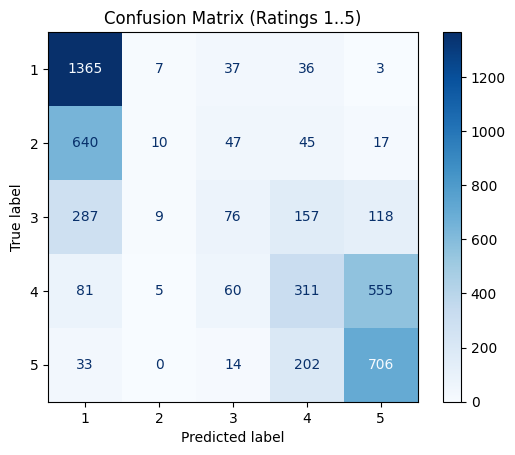

In [ ]:
# Import libraries
import numpy as np
import pandas as pd
import tensorflow as tf
from transformers import AutoTokenizer, TFAutoModelForSequenceClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import os

# Check GPU availability
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# Assuming data_train is already loaded
# Example: Replace with your data source
# data_train = pd.read_csv('your_data.csv')

# Display first few rows of data_train for verification
print(data_train.head())

# Prepare labels (shift ratings from 1..5 to 0..4 for compatibility)
data_train['note_shifted'] = data_train['note'] - 1
print("Unique rating values after shifting:", data_train['note_shifted'].unique())  # Should be [0,1,2,3,4]

# Extract texts and labels
X = data_train['clean_text'].tolist()
y = data_train['note_shifted'].values  # Ratings from 0 to 4

# Train/Test Split
X_train_texts, X_test_texts, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)
print(f"Train size: {len(X_train_texts)}, Test size: {len(X_test_texts)}")

# Load model and tokenizer
model_name = "roberta-base"
num_labels = 5  # For labels 0-4

# Initialize tokenizer
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Tokenize the text data
max_length = 128  # Adjust based on your data
train_encodings = tokenizer(
    X_train_texts, truncation=True, padding=True, max_length=max_length
)
test_encodings = tokenizer(
    X_test_texts, truncation=True, padding=True, max_length=max_length
)

# Prepare TensorFlow datasets
def encode_data(encodings, labels):
    return tf.data.Dataset.from_tensor_slices((
        {
            "input_ids": encodings['input_ids'],
            "attention_mask": encodings['attention_mask']
        },
        labels
    ))

train_dataset = encode_data(train_encodings, y_train)
test_dataset = encode_data(test_encodings, y_test)

batch_size = 16  # Adjust based on GPU memory
train_dataset = train_dataset.shuffle(buffer_size=1000).batch(batch_size).prefetch(tf.data.AUTOTUNE)
test_dataset = test_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

# Load RoBERTa model for sequence classification
model = TFAutoModelForSequenceClassification.from_pretrained(
    model_name,
    num_labels=num_labels
)

# Compile the model with optimizer and loss function
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=5e-5),  # Adjust learning rate if needed
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"]
)

# Display model summary
model.summary()

# Set up TensorBoard callback
log_dir = "logs/roberta_classification"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

# Early Stopping callback to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

# Train the model
epochs = 3  # Adjust based on your needs
history = model.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=epochs,
    callbacks=[early_stopping, tensorboard_callback],
    steps_per_epoch=len(train_dataset)
)

# Evaluate the model on test dataset
results = model.evaluate(test_dataset)
print(f"\nTest Loss: {results[0]:.4f}, Test Accuracy: {results[1]:.4f}")

# Make predictions on test dataset
pred_logits = model.predict(test_dataset).logits
y_pred = np.argmax(pred_logits, axis=1)  # Predictions in [0,1,2,3,4]

# Adjust predictions back to original rating scale 1..5
y_pred_adjusted = y_pred + 1
y_test_adjusted = y_test + 1

# Evaluation Metrics
acc = accuracy_score(y_test_adjusted, y_pred_adjusted)
f1 = f1_score(y_test_adjusted, y_pred_adjusted, average='weighted')
print(f"Accuracy: {acc:.4f}, F1 Score: {f1:.4f}")

# Classification Report
report = classification_report(
    y_test_adjusted,
    y_pred_adjusted,
    labels=[1,2,3,4,5],
    target_names=["1","2","3","4","5"]
)
print("Classification Report:")
print(report)

# Confusion Matrix
cm = confusion_matrix(y_test_adjusted, y_pred_adjusted, labels=[1,2,3,4,5])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["1","2","3","4","5"])
disp.plot(cmap='Blues')
plt.title("Confusion Matrix (Ratings 1..5)")
plt.show()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/roberta_classification

<IPython.core.display.Javascript object>

# Llama 3.2 1B with LoRA

Some weights of LlamaForSequenceClassification were not initialized from the model checkpoint at meta-llama/Llama-3.2-1B and are newly initialized: ['score.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Map:   0%|          | 0/19281 [00:00<?, ? examples/s]

Map:   0%|          | 0/4821 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1575: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.
wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Résultats d'évaluation : {'eval_loss': 1.1878145933151245, 'eval_model_preparation_time': 0.0072, 'eval_accuracy': 0.47873885086081724, 'eval_runtime': 65.4555, 'eval_samples_per_second': 73.653, 'eval_steps_per_second': 4.614}


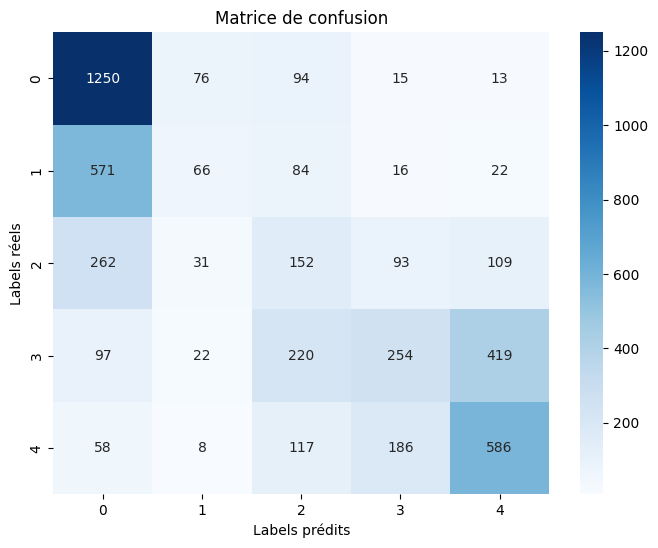

In [ ]:
import torch
from sklearn.model_selection import train_test_split
import datasets
from datasets import DatasetDict
from transformers import (
    AutoTokenizer, AutoModelForSequenceClassification,
    DataCollatorWithPadding, TrainingArguments, Trainer
)
from peft import get_peft_model, LoraConfig, TaskType
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns


# --- Configuration ---
batch_size = 16  # Taille de batch
num_epochs = 10  # Nombre d'epochs
lr = 1e-4       # Taux d'apprentissage


#
roberta_checkpoint = "roberta-large"  # Modèle préentraîné
llama_1B_checkpoint = "meta-llama/Llama-3.2-1B"
# weights_path = "/content/drive/MyDrive/projet_2_NLP/Llama_1B_token_classification"
weights_path = "ballec"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Sélection du device (GPU/CPU)

# --- Préparation des données ---
data_train['clean_text'] = data_train['tokenized_avis'].apply(lambda tokens: ' '.join(tokens))
X = data_train['clean_text']
y = data_train['note']


# Diviser les données en ensembles d'entraînement et de validation
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Convertir les labels en tenseurs PyTorch
y_train, y_test = map(
    lambda y: torch.tensor(y.to_list(), dtype=torch.int64) - 1,
    (y_train, y_test)
)

# Créer des datasets Hugging Face
dataset = DatasetDict(
    train=datasets.Dataset.from_dict({"text": X_train, "labels": y_train}).shuffle(seed=1111),
    val=datasets.Dataset.from_dict({"text": X_test, "labels": y_test}).shuffle(seed=1111)
)

# --- Tokenisation ---
# Charger et configurer le tokenizer
tokenizer = AutoTokenizer.from_pretrained(llama_1B_checkpoint, add_prefix_space=True)
tokenizer.pad_token_id = tokenizer.eos_token_id
tokenizer.pad_token = tokenizer.eos_token

# Tokeniser les données avec padding et troncation
tokenized_dataset = dataset.map(
    lambda example: tokenizer(example['text'], padding=True, truncation=True),
    batched=True,
    batch_size=16
).remove_columns(["text"]) #.set_format("torch")

# Préparer un collateur de données pour le padding dynamique
data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

# --- Modèle et LoRA ---
# Charger le modèle préentraîné
model = AutoModelForSequenceClassification.from_pretrained(
    pretrained_model_name_or_path=llama_1B_checkpoint,
    num_labels=5
).to(device)

# Configurer LoRA pour un fine-tuning léger
peft_config = LoraConfig(
    task_type=TaskType.SEQ_CLS, r=2, lora_alpha=16, lora_dropout=0.1, bias="none"
)
model = get_peft_model(model, peft_config)
model.print_trainable_parameters()
model.config.pad_token_id = tokenizer.pad_token_id  # Vérifier la configuration du token de padding

# --- Entraînement ---
# Configurer les arguments d'entraînement
training_args = TrainingArguments(
    output_dir= weights_path,
    learning_rate=lr,
    lr_scheduler_type="constant",
    warmup_ratio=0.1,
    max_grad_norm=0.3,
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    num_train_epochs=num_epochs,
    weight_decay=0.001,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    fp16=torch.cuda.is_available(),
    gradient_checkpointing=True,
    # report_to="none"  # Désactiver l'intégration avec wandbavec token : 85de86777e99b920ac6a1b42ff2cfb58d4aeb8fa
)

# Définir une fonction pour calculer les métriques
def compute_metrics(eval_pred):
    logits, labels = eval_pred
    preds = torch.argmax(torch.tensor(logits).to(device), dim=1)  # S'assurer que le device est correct
    accuracy = accuracy_score(labels, preds.cpu().numpy())
    return {"accuracy": accuracy}

# Initialiser le Trainer
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_dataset['train'],
    eval_dataset=tokenized_dataset['val'],
    data_collator=data_collator,
    compute_metrics=compute_metrics
)

# Lancer l'entraînement
trainer.train()

# --- Évaluation et Analyse ---
# Évaluer le modèle
results = trainer.evaluate()
print("Résultats d'évaluation :", results)

# Prédictions pour la matrice de confusion
predictions = trainer.predict(tokenized_dataset['val'])
y_true = predictions.label_ids
y_pred = torch.argmax(torch.tensor(predictions.predictions), dim=1).cpu().numpy()

# Matrice de confusion
conf_matrix = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=range(5), yticklabels=range(5))
plt.xlabel("Labels prédits")
plt.ylabel("Labels réels")
plt.title("Matrice de confusion")
plt.show()

# Rapport de classification
print("Rapport de classification :")
print(classification_report(y_true, y_pred, target_names=[f"Classe {i}" for i in range(5)]))



model.push_to_hub(full_repo_name, adapter_name="default_adapter", token = "yourtoken")
tokenizer.push_to_hub(full_repo_name)

print(f"Modèle LoRA poussé vers Hugging Face Hub : {full_repo_name}")


### Test for deployment : Importing the model from file and classify data




In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from peft import get_peft_model, LoraConfig, TaskType, PeftModel
import torch

# --- Configuration ---
weights_path = "/content/drive/MyDrive/projet_2_NLP/Roberta_token_classification/checkpoint-100"  # Chemin des checkpoints
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Utiliser GPU si disponible

# --- Charger le tokenizer ---
roberta_checkpoint = "roberta-large"  # Modèle de base utilisé pour le fine-tuning
tokenizer = AutoTokenizer.from_pretrained(roberta_checkpoint, add_prefix_space=True)
tokenizer.pad_token_id = tokenizer.eos_token_id
tokenizer.pad_token = tokenizer.eos_token

# --- Charger le modèle de base ---
m = AutoModelForSequenceClassification.from_pretrained(
    pretrained_model_name_or_path=roberta_checkpoint,
    num_labels=5  # Nombre de classes
)

# --- Charger le modèle LoRA fine-tuné ---
# Charger directement le modèle avec LoRA fine-tuné depuis les checkpoints
model = PeftModel.from_pretrained(m,
    model_id=weights_path,  # Chemin contenant adapter_model.safetensors et adapter_config.json
)
model.to(device)

# --- Exemple pour prédiction ---
# Prendre un exemple de X_train
example_text = X_train.iloc[0]  # Première donnée de X_train

# Tokeniser l'exemple
inputs = tokenizer(
    example_text,
    padding=True,
    truncation=True,
    return_tensors="pt"  # Retourner un tenseur PyTorch
).to(device)

# Faire une prédiction
model.eval()  # Mettre le modèle en mode évaluation
with torch.no_grad():  # Pas besoin de calcul des gradients
    outputs = model(**inputs)
    logits = outputs.logits
    prediction = torch.argmax(logits, dim=1).item()  # Prendre le label prédit

# Afficher les résultats
print(f"Texte : {example_text}")
print(f"Logits : {logits}")
print(f"Label prédit : {prediction}")


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-large and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Texte : Étant en train d'acheter un nouveau scooter, le concessionnaire me demande l'attestation de l'assurance prouvant que j'ai bien conduit un 125cm3 en 2006 et 2011 comme la loi le demande. La Macif ne me l'a jamais fourni et lorsque j'appelle, ils me répondent qu'ils ne peuvent pas car cela est trop ancien. Je suis en train de perdre mon acompte. Incapable de taper un simple attestation et en plus, ils me disent de passer la formation de 7h alors que je n'en ai pas besoin. Irréaliste ! Vraiment très déçu et après presque 30 ans chez eux, j'envisage d'aller voir ailleurs pour mes 2 véhicules. Le discours au téléphone était hallucinant. La personne me mettait en attente pour allez à la pêche au informations. Un simple papier spécifiant mon passé d'assuré pour un 2 roues sous prétexte que c'était trop ancien !!! Elle m'a répondu qu'elle ne pouvait pas remonter entre 20 et 30 ans. Nous sommes en 2019 et la durée demandée est comprise entre 2006 et 2011. Si je n'obtient pas ce document